In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
from sklearn.ensemble import IsolationForest

In [ ]:
data = pd.read_csv('Scenario_Data_Set.csv')
data.head()

,datetime,depth,variable,value
0,2016-01-18 23:58:39.589292244,1.031,water temperature,25.746673
1,2016-01-19 00:01:08.681715784,2.039,water temperature,26.322298
2,2016-01-19 00:02:41.118574888,3.036,water temperature,25.831906
3,2016-01-19 00:05:43.701587115,4.050,water temperature,22.017589
4,2016-01-19 00:03:46.335690866,4.985,water temperature,20.484654


## Initial Data Inspection

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98344 entries, 0 to 98343
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   datetime  98344 non-null  object 
 1   depth     98226 non-null  float64
 2   variable  98344 non-null  object 
 3   value     98344 non-null  float64
dtypes: float64(2), object(2)
memory usage: 3.0+ MB


In [ ]:
missing_values = data.isnull().sum()
print(f"Missing values before conversion: {missing_values:}.")

Missing values before conversion: datetime      0
depth       118
variable      0
value         0
dtype: int64.


In [ ]:
#Check for Missing Values

missing_values = data.isnull().sum().sum()
print(f"Missing values before conversion: {missing_values:}.")
total_cells = np.product(data.shape)
percent_missing = (missing_values/total_cells)*100
print(f"The percentage of missing values in the dataset is {percent_missing:.3f}%.")

Missing values before conversion: 118.
The percentage of missing values in the dataset is 0.030%.


In [ ]:
# Convert datetime to Timestamp Format for time-series analysis

data['datetime'] = pd.to_datetime (data['datetime'], errors='coerce')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98344 entries, 0 to 98343
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   datetime  98344 non-null  datetime64[ns]
 1   depth     98226 non-null  float64       
 2   variable  98344 non-null  object        
 3   value     98344 non-null  float64       
dtypes: datetime64[ns](1), float64(2), object(1)
memory usage: 3.0+ MB


## Handling Missing Values

In [ ]:
# Impute Missing Values in depth with mean of this feature

mean_depth = data['depth'].mean()

data_cleaned = data.copy()
data_cleaned['depth'].fillna(mean_depth, inplace =True)

<ipython-input-12-9c4759693c90>:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data_cleaned['depth'].fillna(mean_depth, inplace =True)


In [ ]:
data_cleaned = data_cleaned.dropna()

In [ ]:
missing_values = data_cleaned.isnull().sum().sum()
print(f"Missing values before conversion: {missing_values:}.")

Missing values before conversion: 0.


In [ ]:
# Summary statistics for numeric columns only
numeric_summary_statistics = data_cleaned.describe()
print(numeric_summary_statistics)

                            datetime         depth         value
count                          98344  98344.000000  98344.000000
mean   2016-02-16 23:26:59.126551552     36.428157     10.713328
min    2016-01-18 23:58:39.589292244      0.935000      0.000000
25%    2016-02-02 04:11:04.340640512     18.069000      4.056058
50%    2016-02-17 06:24:33.474826240     36.077999      7.653724
75%    2016-03-02 18:05:51.679256320     53.993000     14.124762
max    2016-03-17 08:59:01.213116098     71.999001    131.349364
std                              NaN     20.729952      9.347187


## Exploratory Data Analysis (EDA)

In [ ]:
# Generate summary statistics for 'value' grouped by 'variable' and 'depth'

summary_stats = data.groupby(['variable', 'depth'])['value'].describe()
print(summary_stats)


                             count       mean       std        min        25%  \
variable          depth                                                         
dissolved oxygen  0.935000     1.0   7.023624       NaN   7.023624   7.023624   
                  0.939000     1.0   7.833521       NaN   7.833521   7.833521   
                  0.945000     1.0   8.845799       NaN   8.845799   8.845799   
                  0.953000     1.0   6.923615       NaN   6.923615   6.923615   
                  0.956000     1.0   8.134048       NaN   8.134048   8.134048   
...                            ...        ...       ...        ...        ...   
water temperature 71.995003    7.0  12.196174  1.447967  10.450830  11.134842   
                  71.996002    3.0  13.950287  1.193831  12.581008  13.538979   
                  71.997002    3.0  13.164240  1.251125  11.844493  12.579835   
                  71.998001    2.0  12.165299  0.738094  11.643388  11.904343   
                  71.999001 

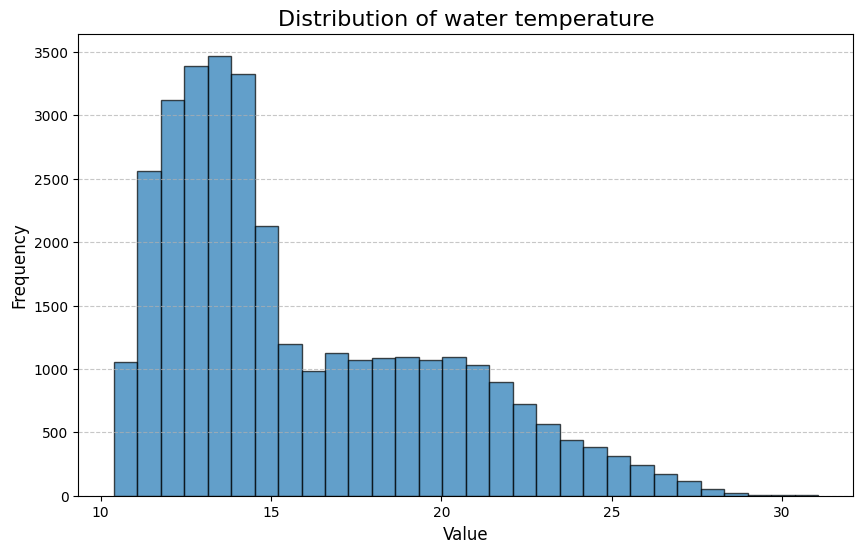

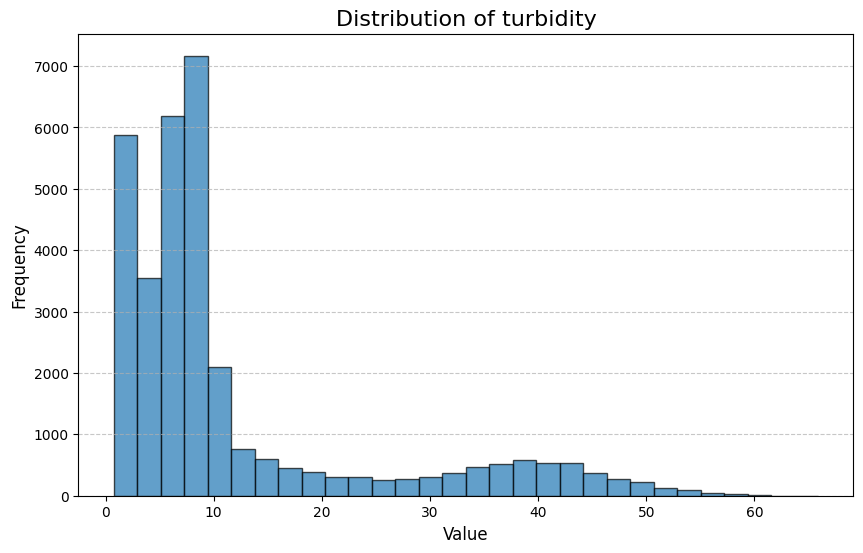

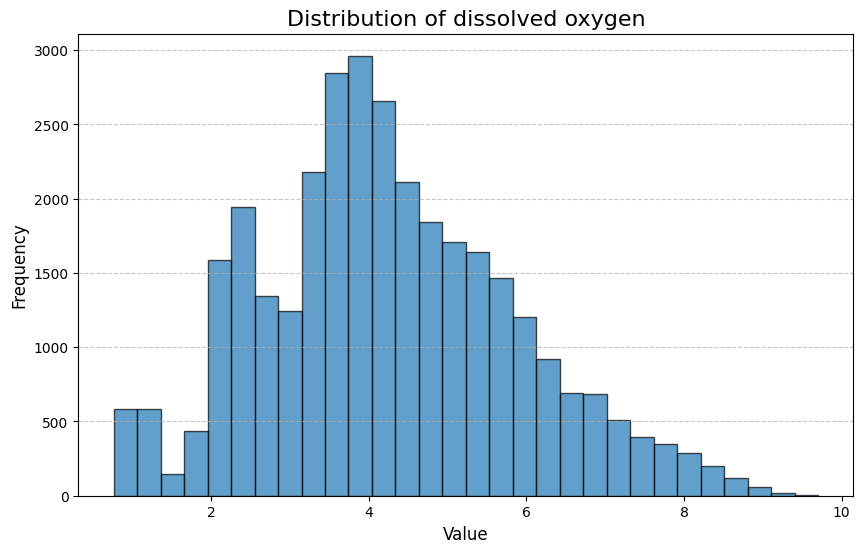

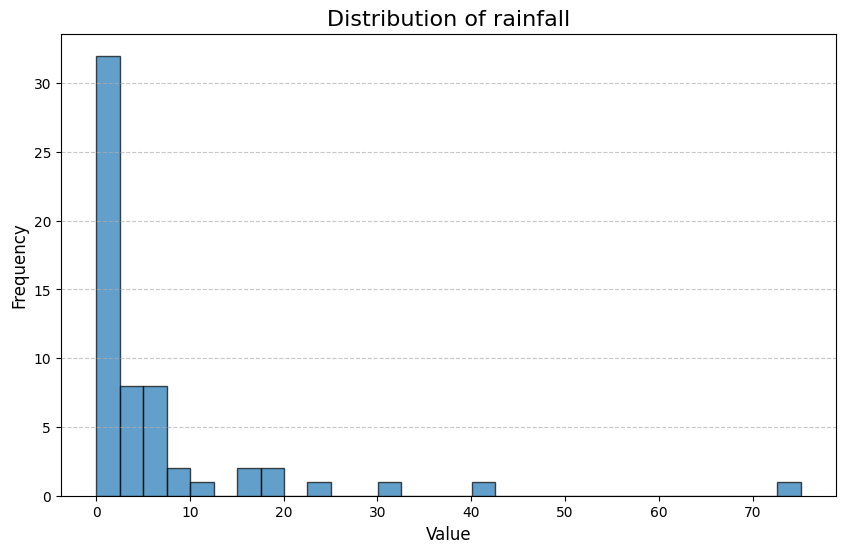

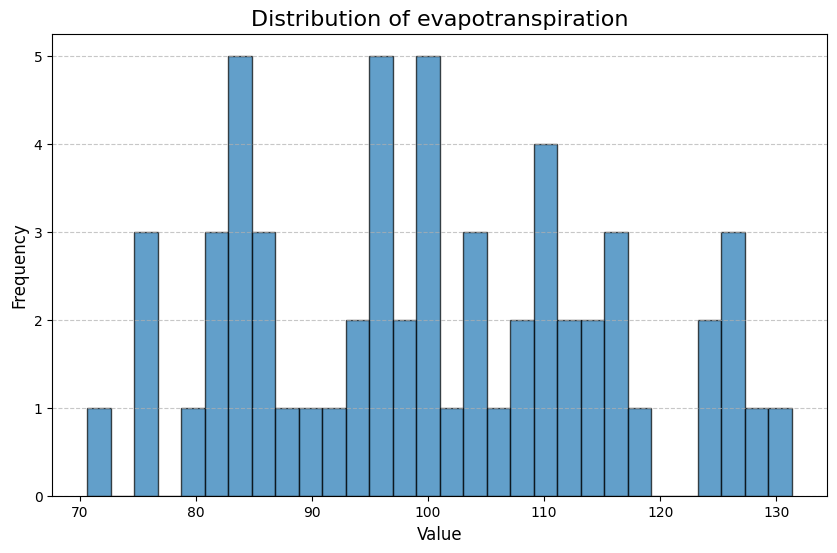

In [ ]:

# Set consistent styling for plots
plt.style.use('default')

# Visualize the distribution of key water quality indicators
for variable in data_cleaned['variable'].unique():
    subset = data_cleaned[data_cleaned['variable'] == variable]
    plt.figure(figsize=(10, 6))  # Larger figure size
    plt.hist(subset['value'], bins=30, alpha=0.7, edgecolor='black')
    plt.title(f"Distribution of {variable}", fontsize=16)
    plt.xlabel("Value", fontsize=12)
    plt.ylabel("Frequency", fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)  # Add gridlines
    plt.show()


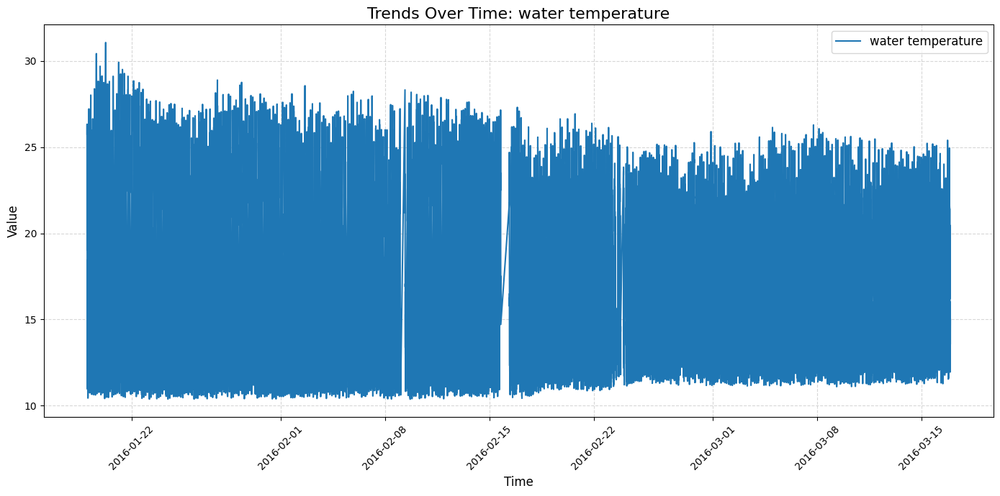

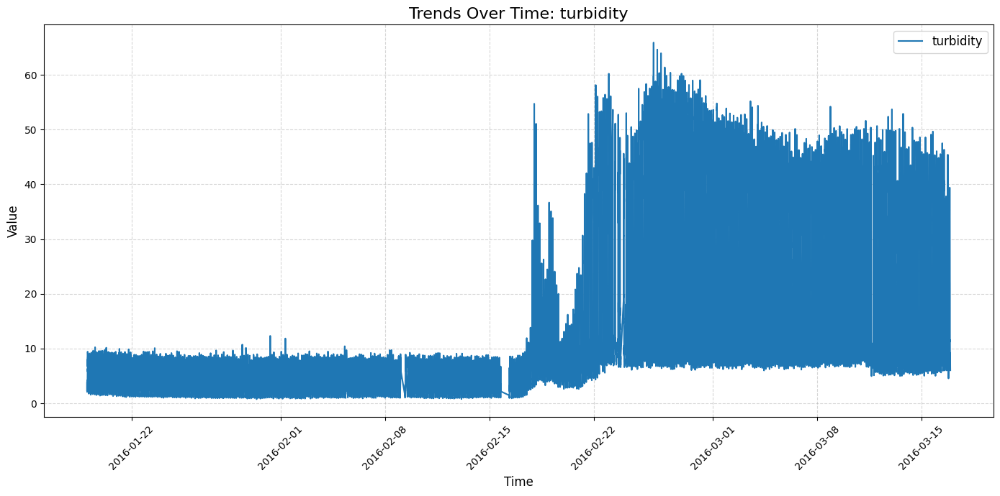

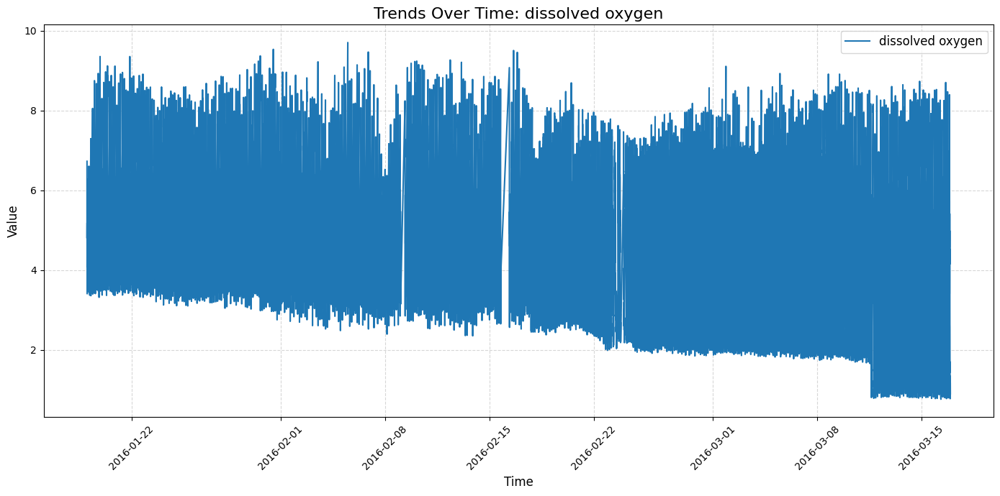

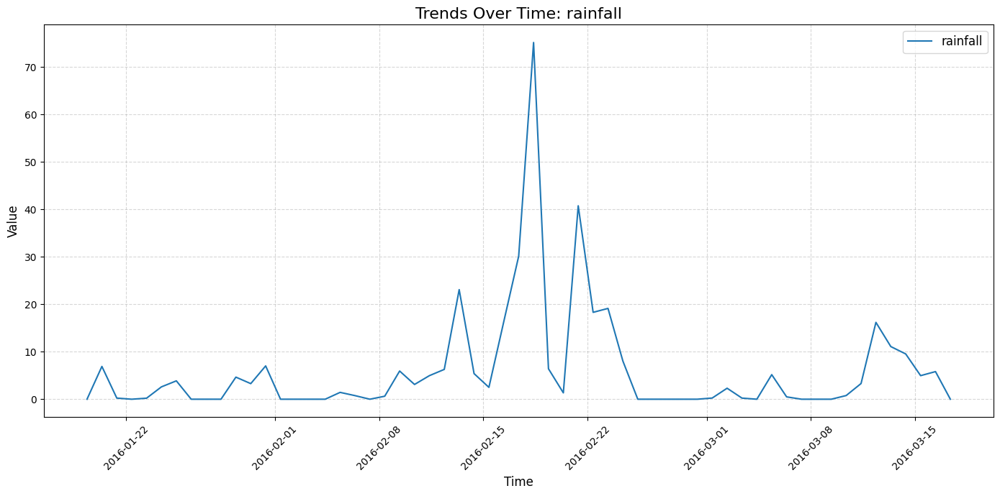

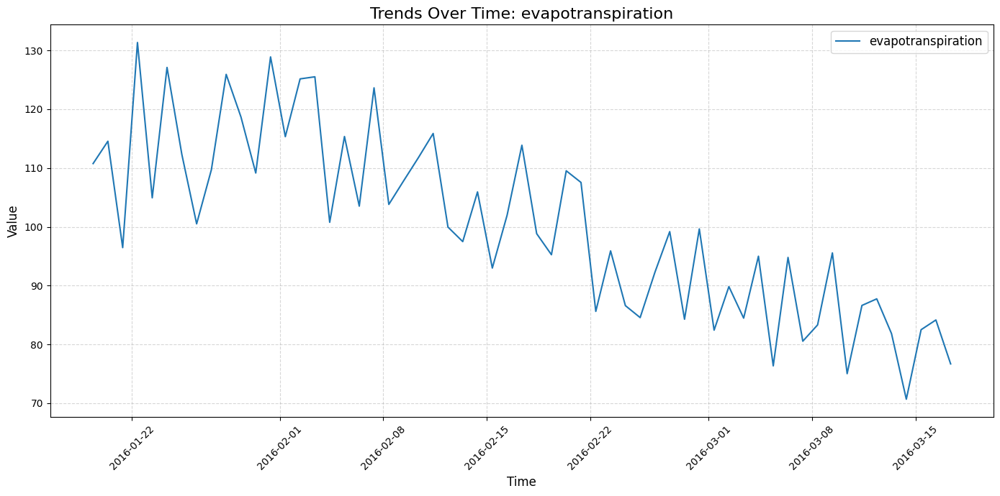

In [ ]:
# Visualize trends over time for each variable

for variable in data_cleaned['variable'].unique():
    subset = data_cleaned[data_cleaned['variable'] == variable]
    plt.figure(figsize=(14, 7))  # Larger figure size for time-series
    plt.plot(subset['datetime'], subset['value'], label=variable, linewidth=1.5)
    plt.title(f"Trends Over Time: {variable}", fontsize=16)
    plt.xlabel("Time", fontsize=12)
    plt.ylabel("Value", fontsize=12)
    plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
    plt.legend(loc='best', fontsize=12)  # Add a legend
    plt.grid(axis='both', linestyle='--', alpha=0.5)  # Add gridlines
    plt.tight_layout()  # Adjust layout to prevent label overlap
    plt.show()


1. Calculate Anomalies using Z-Score
Anomalies are identified as data points with Z-scores above a certain threshold (e.g., 3 or -3).

In [ ]:
import numpy as np

# Calculate the Z-scores for the 'value' column
data['z_score'] = (data['value'] - data['value'].mean()) / data['value'].std()

# Define anomalies as points with Z-score > 3 or < -3
anomalies_z_score = data[np.abs(data['z_score']) > 3]

print(f"Number of anomalies detected (Z-score method): {len(anomalies_z_score)}")
anomalies_z_score.head()


Number of anomalies detected (Z-score method): 2628


,datetime,depth,variable,value,z_score
49533,2016-02-18 00:12:02.054889809,8.866,turbidity,39.922512,3.124917
49536,2016-02-18 00:16:13.164105473,11.801,turbidity,54.728247,4.708895
49537,2016-02-18 00:17:16.474263878,12.777,turbidity,52.764988,4.498857
49538,2016-02-18 00:18:16.543486542,13.743,turbidity,46.762796,3.856718
49604,2016-02-18 03:12:03.915369178,8.873,turbidity,42.298016,3.379058


 2: Detect Anomalies using Interquartile Range (IQR)
The IQR method flags points that lie outside 1.5 times the IQR below the 1st quartile or above the 3rd quartile.

In [ ]:
# Calculate IQR
Q1 = data['value'].quantile(0.25)
Q3 = data['value'].quantile(0.75)
IQR = Q3 - Q1

# Define the bounds for anomalies
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify anomalies
anomalies_iqr = data[(data['value'] < lower_bound) | (data['value'] > upper_bound)]

print(f"Number of anomalies detected (IQR method): {len(anomalies_iqr)}")
anomalies_iqr.head()


Number of anomalies detected (IQR method): 4568


,datetime,depth,variable,value,z_score
359,2016-01-19 14:59:27.867620658,1.043,water temperature,30.414529,2.107714
503,2016-01-19 21:01:53.520536248,3.052,water temperature,29.684528,2.029616
717,2016-01-20 06:02:04.400449693,1.021,water temperature,31.058897,2.176652
1221,2016-01-21 02:59:21.768267298,1.035,water temperature,29.908031,2.053527
1222,2016-01-21 03:01:06.757089886,2.068,water temperature,29.424686,2.001817


3: Visualize Anomalies using Boxplot
Boxplots help in visually identifying outliers.

In [ ]:
import plotly.express as px

# Create a boxplot for the 'value' column
fig_boxplot = px.box(
    data,
    y='value',
     title="Distribution and Outliers in Water Quality Measurements",
    labels={"value": "Water Quality Parameter Measurements"},
    points="all"  # Show all points including outliers
)
fig_boxplot.show()


 4: Highlight Anomalies on a Scatter Plot
Visualize anomalies in the context of time or depth.

In [ ]:
# Create a scatter plot highlighting anomalies
fig_anomalies = px.scatter(
    data,
    x="datetime",
    y="value",
    color=np.abs(data['z_score']) > 3,  # Highlight anomalies
    title="Anomalies in Water Quality Parameters Over Time",
    labels={"value": "Water Quality Parameter", "datetime": "Timestamp"}
)
fig_anomalies.show()


In [ ]:
### 1. Interquartile Range (IQR) Method
def identify_outliers_iqr(data, column):
    Q1 = data[column].quantile(0.25)  # First quartile (25th percentile)
    Q3 = data[column].quantile(0.75)  # Third quartile (75th percentile)
    IQR = Q3 - Q1  # Interquartile range

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Identify outliers
    outliers = data[(data[column] < lower_bound) | (data[column] > upper_bound)]
    return outliers, lower_bound, upper_bound

# Apply IQR method to the 'value' column
outliers_iqr, lower_bound_iqr, upper_bound_iqr = identify_outliers_iqr(data_cleaned, 'value')
print(f"IQR Method: {len(outliers_iqr)} outliers detected")

### 2. Z-Score Method
def identify_outliers_zscore(data, column, threshold=3):
    # Calculate Z-scores
    data['z_score'] = zscore(data[column])

    # Identify outliers
    outliers = data[(data['z_score'] > threshold) | (data['z_score'] < -threshold)]
    return outliers

# Apply Z-Score method to the 'value' column
outliers_z = identify_outliers_zscore(data_cleaned, 'value')
print(f"Z-Score Method: {len(outliers_z)} outliers detected")

### 3. Isolation Forest Method
def identify_anomalies_isolation_forest(data, column, contamination=0.01):
    # Prepare data for the model
    X = data[[column]]

    # Fit the Isolation Forest model
    model = IsolationForest(contamination=contamination, random_state=42)
    data['anomaly'] = model.fit_predict(X)

    # Anomalies have a label of -1
    anomalies = data[data['anomaly'] == -1]
    return anomalies

IQR Method: 4568 outliers detected
Z-Score Method: 2628 outliers detected


In [ ]:

# Apply Isolation Forest to the 'value' column
anomalies = identify_anomalies_isolation_forest(data_cleaned, 'value')
print(f"Isolation Forest Method: {len(anomalies)} anomalies detected")

### Summary of Results
print("\nSummary:")
print(f"IQR Method: {len(outliers_iqr)} outliers")
print(f"Z-Score Method: {len(outliers_z)} outliers")
print(f"Isolation Forest Method: {len(anomalies)} anomalies")

Isolation Forest Method: 965 anomalies detected

Summary:
IQR Method: 4568 outliers
Z-Score Method: 2628 outliers
Isolation Forest Method: 965 anomalies


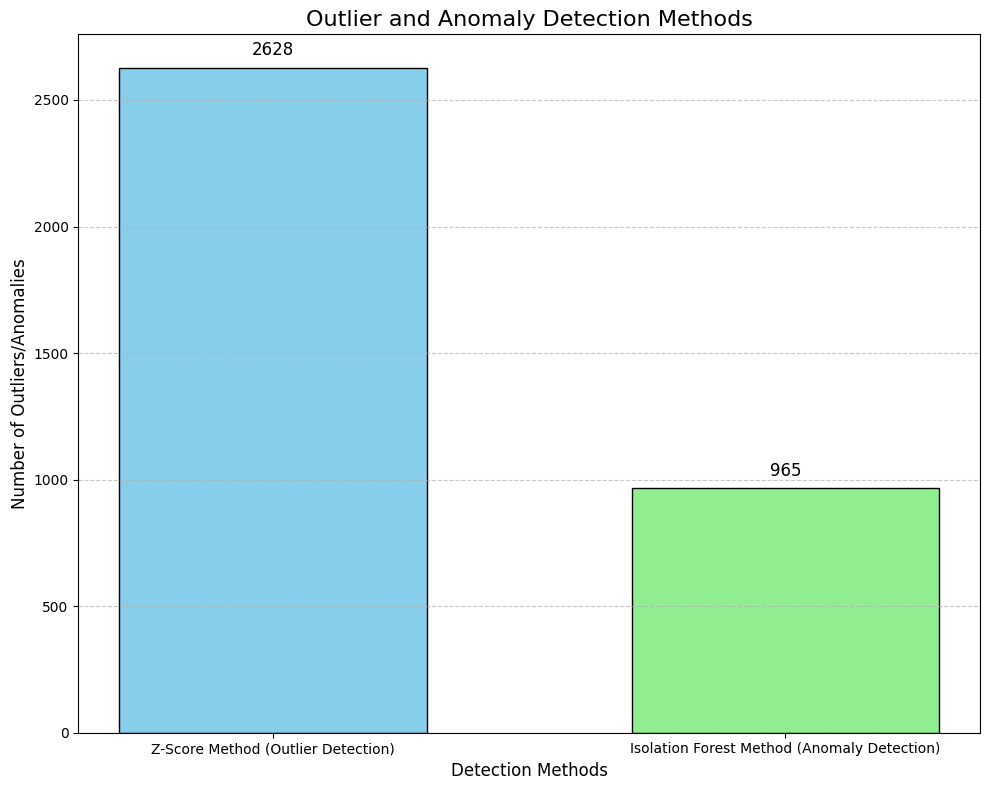

In [ ]:
import matplotlib.pyplot as plt

# Data for the chart
methods = ['Z-Score Method (Outlier Detection)', 'Isolation Forest Method (Anomaly Detection)']
outliers_count = [2628, 965]

# Colors for bars
colors = ['skyblue', 'lightgreen']

# Plotting the bar chart
plt.figure(figsize=(10, 8))
plt.bar(methods, outliers_count, color=colors, width=0.6, edgecolor='black')
plt.title("Outlier and Anomaly Detection Methods", fontsize=16)
plt.xlabel("Detection Methods", fontsize=12)
plt.ylabel("Number of Outliers/Anomalies", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Annotate counts on top of bars
for i, count in enumerate(outliers_count):
    plt.text(i, count + 50, str(count), ha='center', fontsize=12)

# Adjust layout and display
plt.tight_layout()
plt.show()


## Comprehensive Analysis Techniques


### 1. Correlation Analysis: Investigate relationships between weather conditions (e.g., rainfall, evaporation) and water quality parameters.
Assuming that variable contains both water quality parameters (e.g., turbidity, dissolved oxygen) and weather conditions (e.g., rainfall, evaporation), we can calculate correlations for these variables.

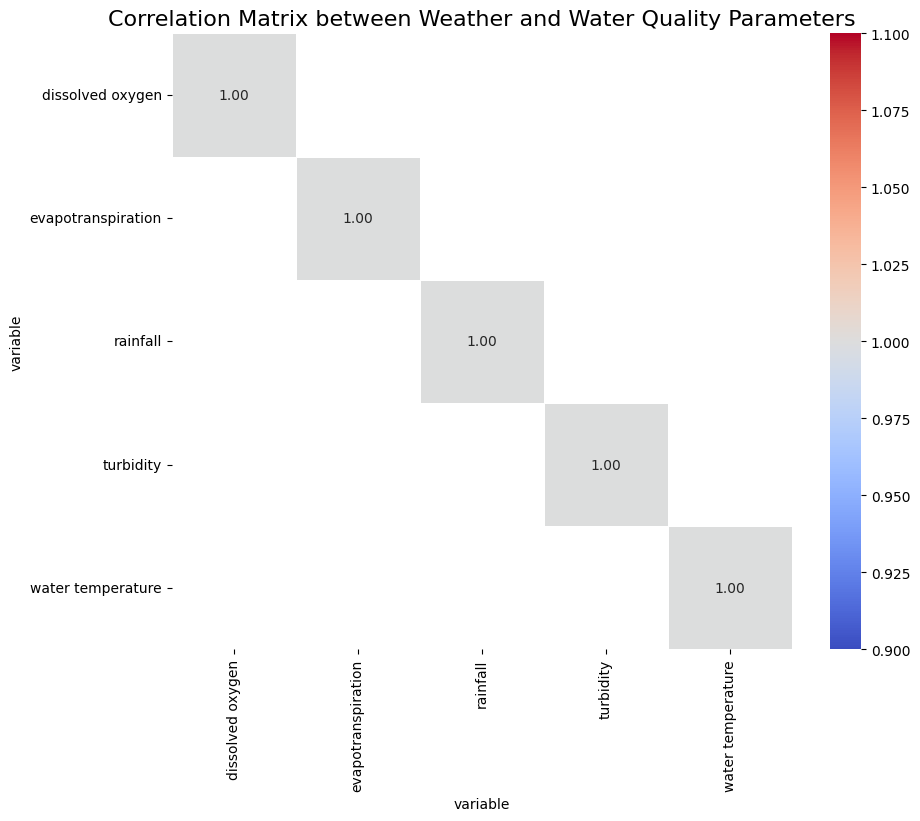

In [ ]:
# Pivot data for correlation analysis
correlation_data = data_cleaned.pivot(index='datetime', columns='variable', values='value')

# Compute the correlation matrix
correlation_matrix = correlation_data.corr()



plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title("Correlation Matrix between Weather and Water Quality Parameters", fontsize=16)
plt.show()


### 2. Trend Analysis: Detect long-term changes in water quality indicators (e.g., turbidity, dissolved oxygen).

### 3. Time-Series Analysis (Using FFT for Seasonal Decomposition)


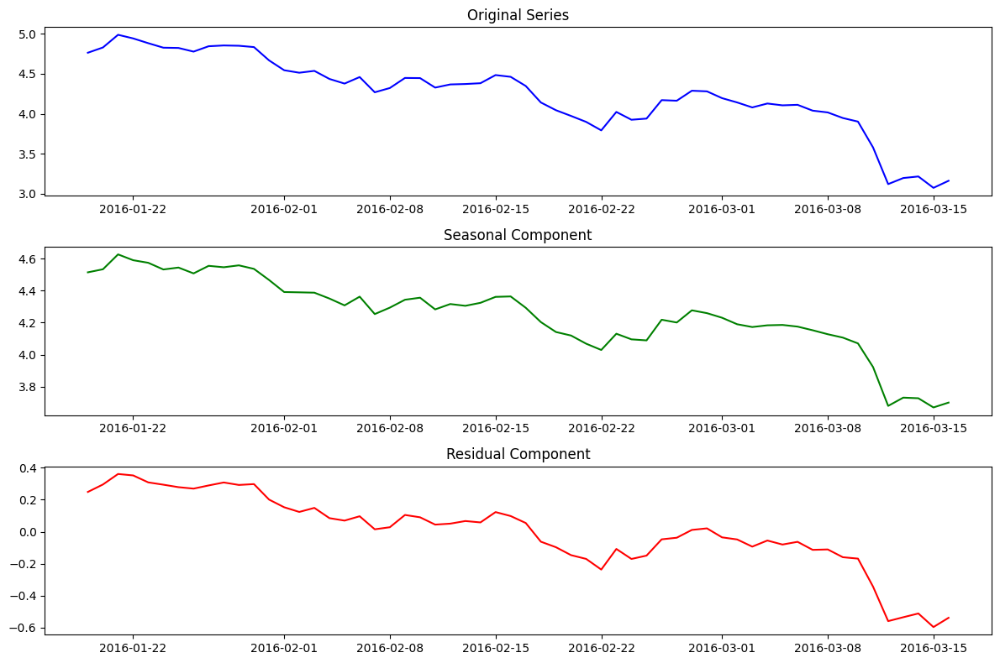

In [ ]:

# Step 1: Use the cleaned dataset and select a variable
variable = 'dissolved oxygen'  # Replace with your variable of interest
time_series_data = data_cleaned[data_cleaned['variable'] == variable]

# Step 2: Sort by datetime and set it as the index
time_series_data = time_series_data.sort_values(by='datetime')
time_series_data.set_index('datetime', inplace=True)

# Step 3: Calculate daily averages
daily_avg = time_series_data['value'].resample('D').mean()  # Resample to daily frequency

# Step 4: Define FFT Decomposition
def fft_decomposition(series, sampling_rate=365):
    """
    Perform FFT decomposition on a time-series.
    Args:
        series (pd.Series): Time-series data.
        sampling_rate (int): Sampling rate for the FFT.
    Returns:
        tuple: Seasonal component and residual component.
    """
    # Calculate the FFT
    fft_result = np.fft.fft(series.dropna())
    frequencies = np.fft.fftfreq(len(series), d=1/sampling_rate)

    # Reconstruct the seasonal component (dominant frequencies)
    seasonal_component = np.fft.ifft(fft_result * (frequencies < 1)).real

    # Residual component
    residual = series - seasonal_component

    return seasonal_component, residual

# Step 5: Apply FFT decomposition to the daily averages
seasonal_component, residual = fft_decomposition(daily_avg)

# Step 6: Plot the decomposition
plt.figure(figsize=(12, 8))

# Original Series
plt.subplot(3, 1, 1)
plt.plot(daily_avg.index, daily_avg, label='Original Series', color='blue')
plt.title("Original Series")

# Seasonal Component
plt.subplot(3, 1, 2)
plt.plot(daily_avg.index, seasonal_component, label='Seasonal Component', color='green')
plt.title("Seasonal Component")

# Residual Component
plt.subplot(3, 1, 3)
plt.plot(daily_avg.index, residual, label='Residual Component', color='red')
plt.title("Residual Component")

plt.tight_layout()
plt.show()


### 4. Time-Series Forecasting (Using scikit-learn Linear Regression)

Linear Regression:
MSE: 81.84, R² Score: 0.0589

Polynomial Regression (Degree 2):
MSE: 81.76, R² Score: 0.0598


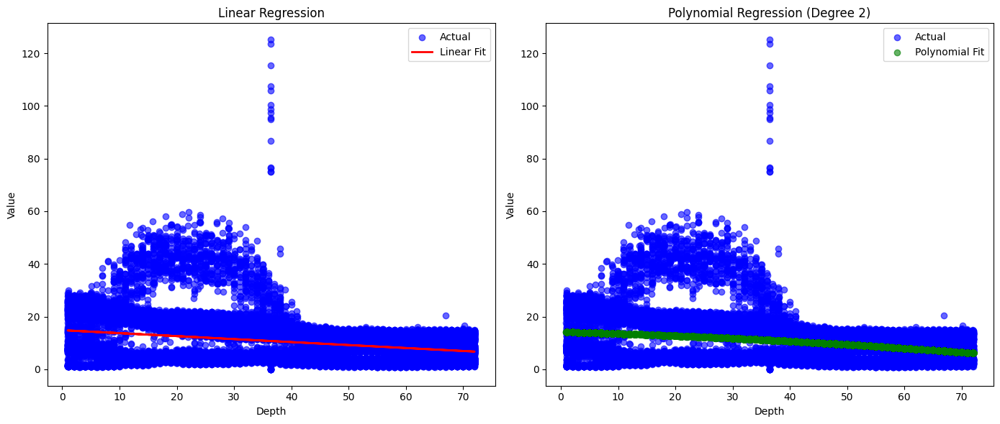

In [ ]:

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, r2_score



# Select independent (X) and dependent (y) variables
# Assuming 'value' as the dependent variable and 'depth' as independent
X = data_cleaned[['depth']]  # Use depth as the predictor variable
y = data_cleaned['value']    # Use value as the target variable

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Linear Regression
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
y_pred_linear = linear_model.predict(X_test)

# Polynomial Regression (degree 2)
poly = PolynomialFeatures(degree=2)
X_train_poly = poly.fit_transform(X_train)
X_test_poly = poly.transform(X_test)

poly_model = LinearRegression()
poly_model.fit(X_train_poly, y_train)
y_pred_poly = poly_model.predict(X_test_poly)

# Evaluate Models
linear_mse = mean_squared_error(y_test, y_pred_linear)
linear_r2 = r2_score(y_test, y_pred_linear)

poly_mse = mean_squared_error(y_test, y_pred_poly)
poly_r2 = r2_score(y_test, y_pred_poly)

print("Linear Regression:")
print(f"MSE: {linear_mse:.2f}, R² Score: {linear_r2:.4f}")

print("\nPolynomial Regression (Degree 2):")
print(f"MSE: {poly_mse:.2f}, R² Score: {poly_r2:.4f}")

# Visualization
plt.figure(figsize=(14, 6))

# Linear Regression Plot
plt.subplot(1, 2, 1)
plt.scatter(X_test, y_test, color='blue', alpha=0.6, label="Actual")
plt.plot(X_test, y_pred_linear, color='red', linewidth=2, label="Linear Fit")
plt.title("Linear Regression")
plt.xlabel("Depth")
plt.ylabel("Value")
plt.legend()

# Polynomial Regression Plot
plt.subplot(1, 2, 2)
plt.scatter(X_test, y_test, color='blue', alpha=0.6, label="Actual")
plt.scatter(X_test, y_pred_poly, color='green', alpha=0.6, label="Polynomial Fit")
plt.title("Polynomial Regression (Degree 2)")
plt.xlabel("Depth")
plt.ylabel("Value")
plt.legend()

plt.tight_layout()
plt.show()



## Dataset Preparation

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split

# Step 1: Select the specific variable for time-series analysis
variable = 'dissolved oxygen'  # Replace with the variable of interest
time_series_data = data_cleaned[data_cleaned['variable'] == variable]

# Step 2: Ensure the data is sorted by time
time_series_data = time_series_data.sort_values(by='datetime')

# Step 3: Use only the datetime as index and values for supervised learning
time_series_data = time_series_data.set_index('datetime')['value']

# Step 4: Create a supervised dataset with lagged values
def create_supervised(data, lag=1):
    """
    Creates a supervised learning dataset with lagged values.
    Args:
        data: A pandas Series (time-series data).
        lag: Number of steps to predict ahead (default is 1).
    Returns:
        A DataFrame with lagged features and targets.
    """
    data_cleaned = pd.DataFrame(data)
    data_cleaned['target'] = data_cleaned.iloc[:, 0].shift(-lag)  # Shift for target values
    data_cleaned = data_cleaned.dropna()  # Drop rows with NaN values
    return data_cleaned

# Step 5: Apply the function to create supervised data
lag = 1  # Lag of 1 for one-step prediction
supervised_data = create_supervised(time_series_data, lag=lag)

# Step 6: Split into features (X) and target (y)
X = supervised_data.iloc[:, 0].values.reshape(-1, 1)  # Feature (current value)
y = supervised_data.iloc[:, 1].values  # Target (next value)

# Step 7: Split into training and testing datasets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"Training set size: {X_train.shape[0]} samples")
print(f"Testing set size: {X_test.shape[0]} samples")


Training set size: 26192 samples
Testing set size: 6549 samples


In [ ]:
from sklearn.svm import SVR

# Train the SVM model
svm_model = SVR(kernel='rbf')
svm_model.fit(X_train, y_train)

# Make predictions
svm_pred = svm_model.predict(X_test)

# Evaluate the model
svm_mae = mean_absolute_error(y_test, svm_pred)
svm_rmse = np.sqrt(mean_squared_error(y_test, svm_pred))
print(f"SVM - MAE: {svm_mae}, RMSE: {svm_rmse}")


SVM - MAE: 0.5275864250583738, RMSE: 0.8470325187588112


In [ ]:
from sklearn.svm import SVR
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import numpy as np

# Train the SVM model
svm_model = SVR(kernel='rbf')
svm_model.fit(X_train, y_train)

# Make predictions
svm_pred = svm_model.predict(X_test)

# Evaluate the model
svm_mae = mean_absolute_error(y_test, svm_pred)
svm_rmse = np.sqrt(mean_squared_error(y_test, svm_pred))
print(f"SVM - MAE: {svm_mae:.4f}, RMSE: {svm_rmse:.4f}")

# Plot Actual vs Predicted
plt.figure(figsize=(12, 6))

# Subset for better visualization
subset_size = 100  # Adjust as needed
subset_y_test = y_test[:subset_size]
subset_svm_pred = svm_pred[:subset_size]

plt.plot(subset_y_test, label="Actual Values", color="blue", marker='o', linestyle='-', markersize=4)
plt.plot(subset_svm_pred, label="Predicted Values (SVM)", color="orange", marker='x', linestyle='-', markersize=4)
plt.title("SVM: Actual vs Predicted Values", fontsize=16)
plt.xlabel("Sample Index", fontsize=12)
plt.ylabel("Value", fontsize=12)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.6)
plt.show()


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import pandas as pd

# Create a binary target column based on a threshold
threshold = 5.0  # Adjust based on your domain knowledge
data_cleaned['target'] = (data_cleaned['value'] >= threshold).astype(int)

# Features (e.g., depth) and target
X = data_cleaned[['depth']]  # Replace with other relevant features
y = data_cleaned['target']  # 1 = safe, 0 = unsafe

# Split into training and testing datasets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [ ]:
from sklearn.svm import SVC

# Train SVM Classifier
svm_model = SVC(kernel='rbf', random_state=42, probability=True)  # Use RBF kernel for non-linear relationships
svm_model.fit(X_train, y_train)

# Predict
svm_pred = svm_model.predict(X_test)

# Evaluate SVM Classifier
print("SVM Classification Report:")
print(classification_report(y_test, svm_pred))
print("SVM Accuracy:", accuracy_score(y_test, svm_pred))

# Confusion Matrix for SVM
svm_cm = confusion_matrix(y_test, svm_pred)


In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Train Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Predict
rf_pred = rf_model.predict(X_test)

# Evaluate Random Forest Classifier
print("Random Forest Classification Report:")
print(classification_report(y_test, rf_pred))
print("Random Forest Accuracy:", accuracy_score(y_test, rf_pred))

# Confusion Matrix for Random Forest
rf_cm = confusion_matrix(y_test, rf_pred)


Random Forest Classification Report:
              precision    recall  f1-score   support

           0       0.28      0.08      0.13      6486
           1       0.67      0.90      0.76     13183

    accuracy                           0.63     19669
   macro avg       0.47      0.49      0.45     19669
weighted avg       0.54      0.63      0.55     19669

Random Forest Accuracy: 0.6282983374853831


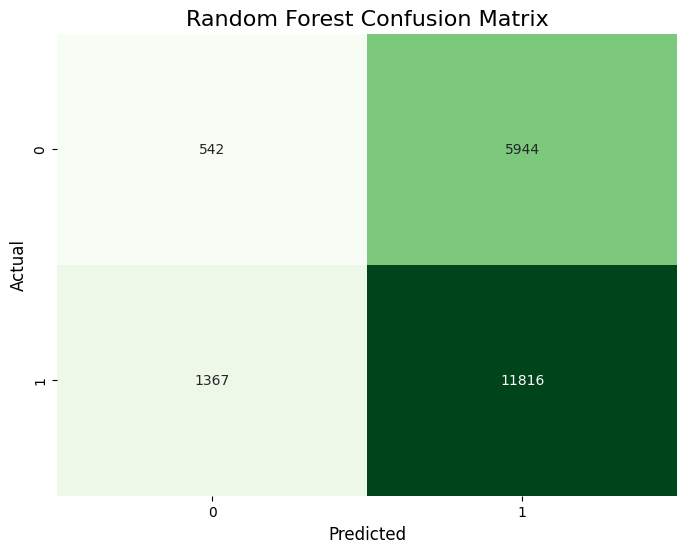

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# # Plot SVM Confusion Matrix
# plt.figure(figsize=(8, 6))
# sns.heatmap(svm_cm, annot=True, fmt="d", cmap="Blues", cbar=False)
# plt.title("SVM Confusion Matrix", fontsize=16)
# plt.xlabel("Predicted", fontsize=12)
# plt.ylabel("Actual", fontsize=12)
# plt.show()

# Plot Random Forest Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(rf_cm, annot=True, fmt="d", cmap="Greens", cbar=False)
plt.title("Random Forest Confusion Matrix", fontsize=16)
plt.xlabel("Predicted", fontsize=12)
plt.ylabel("Actual", fontsize=12)
plt.show()


ADF Statistic: 0.25365095122647147
p-value: 0.9751151821054163
The series is not stationary. Differencing is required.


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



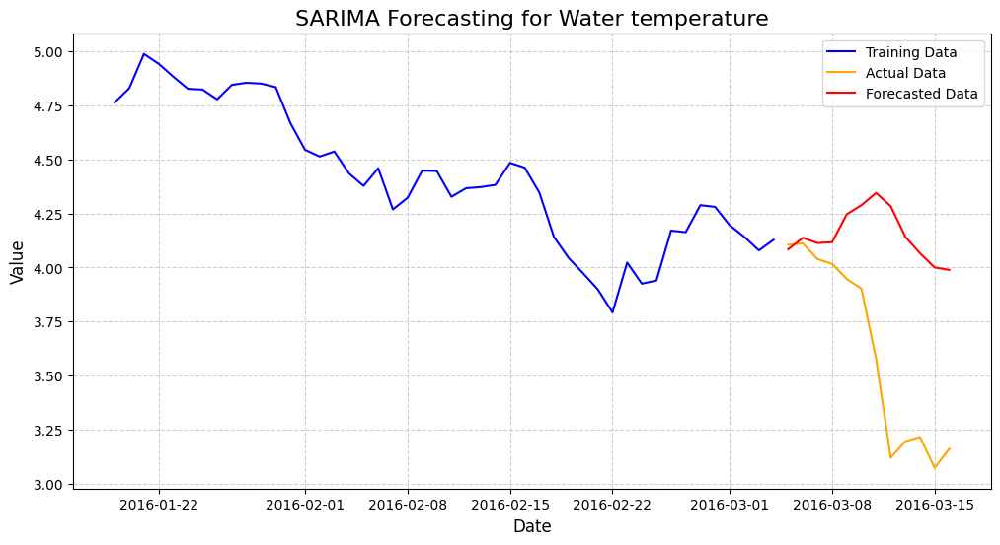

In [ ]:
from statsmodels.tsa.stattools import adfuller

# Perform ADF test to check stationarity
result = adfuller(daily_avg)
print("ADF Statistic:", result[0])
print("p-value:", result[1])
if result[1] <= 0.05:
    print("The series is stationary.")
else:
    print("The series is not stationary. Differencing is required.")

# Apply differencing if necessary
if result[1] > 0.05:
    daily_avg_diff = daily_avg.diff().dropna()
else:
    daily_avg_diff = daily_avg
# Use a larger training set if needed
train_size = int(len(daily_avg) * 0.8)  # Use 90% for training
train, test = daily_avg[:train_size], daily_avg[train_size:]

from statsmodels.tsa.statespace.sarimax import SARIMAX

# Specify seasonal parameters (P, D, Q, s)
sarima_model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 0, 12))
sarima_result = sarima_model.fit()
forecast = sarima_result.forecast(steps=len(test))


# Plot updated results
plt.figure(figsize=(12, 6))
plt.plot(train.index, train, label="Training Data", color="blue")
plt.plot(test.index, test, label="Actual Data", color="orange")
plt.plot(test.index, forecast, label="Forecasted Data", color="red")
plt.title(f"SARIMA Forecasting for {variable.capitalize()}", fontsize=16)
plt.xlabel("Date", fontsize=12)
plt.ylabel("Value", fontsize=12)
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM

# Reshape input for LSTM (samples, time steps, features)
X_train_lstm = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test_lstm = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Build the LSTM model
lstm_model = Sequential()
lstm_model.add(LSTM(64, activation='relu', input_shape=(1, 1)))
lstm_model.add(Dense(1))
lstm_model.compile(optimizer='adam', loss='mse')

# Train the model
lstm_model.fit(X_train_lstm, y_train, epochs=10, batch_size=32, verbose=0)

# Make predictions
lstm_pred = lstm_model.predict(X_test_lstm)

# Evaluate the model
lstm_mae = mean_absolute_error(y_test, lstm_pred)
lstm_rmse = np.sqrt(mean_squared_error(y_test, lstm_pred))
print(f"LSTM - MAE: {lstm_mae}, RMSE: {lstm_rmse}")


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


205/205 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
LSTM - MAE: 0.5502129869038022, RMSE: 0.8446710479013401


In [ ]:
from tensorflow.keras.layers import Bidirectional
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import numpy as np

# Build the BiLSTM model
bilstm_model = Sequential()
bilstm_model.add(Bidirectional(LSTM(128, activation='relu'), input_shape=(1, 1)))
bilstm_model.add(Dense(1))
bilstm_model.compile(optimizer='adam', loss='mse')

# Train the model
bilstm_model.fit(X_train_lstm, y_train, epochs=10, batch_size=32, verbose=0)

# Make predictions
bilstm_pred = bilstm_model.predict(X_test_lstm)

# Evaluate the model
bilstm_mae = mean_absolute_error(y_test, bilstm_pred)
bilstm_rmse = np.sqrt(mean_squared_error(y_test, bilstm_pred))
print(f"BiLSTM - MAE: {bilstm_mae:.4f}, RMSE: {bilstm_rmse:.4f}")


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/bidirectional.py:107: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



205/205 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
BiLSTM - MAE: 0.5438, RMSE: 0.8512


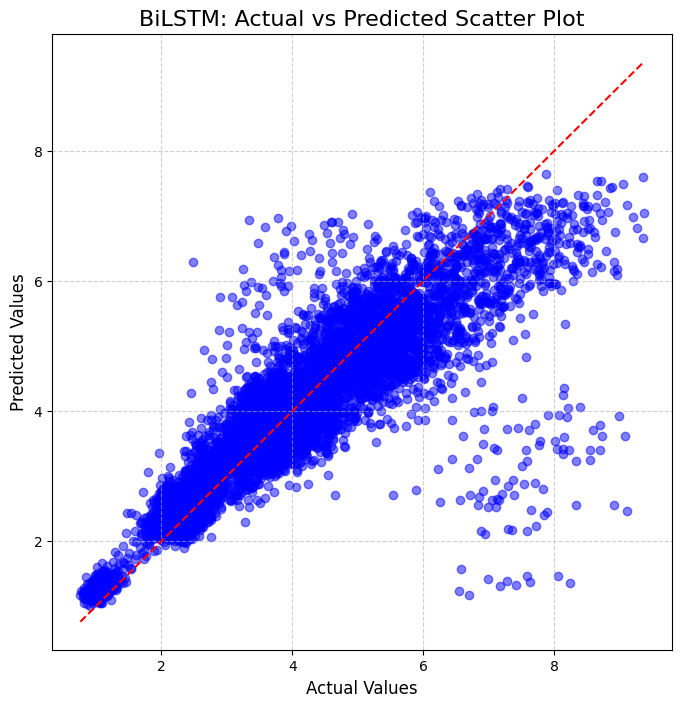

In [ ]:
# Scatter plot of actual vs predicted values
plt.figure(figsize=(8, 8))
plt.scatter(y_test, bilstm_pred, alpha=0.5, color="blue")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color="red", linestyle="--")
plt.title("BiLSTM: Actual vs Predicted Scatter Plot", fontsize=16)
plt.xlabel("Actual Values", fontsize=12)
plt.ylabel("Predicted Values", fontsize=12)
plt.grid(True, linestyle="--", alpha=0.6)
plt.show()


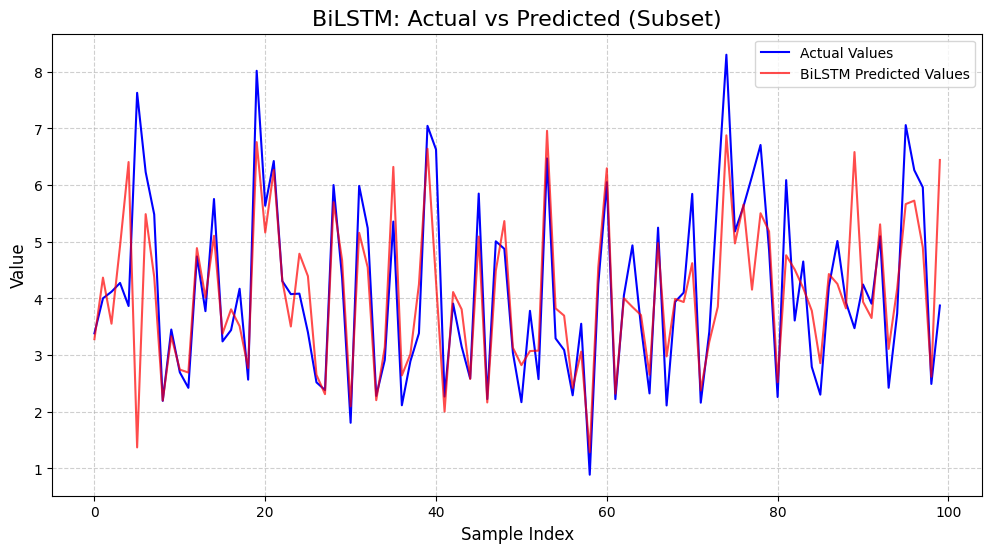

In [ ]:
# Subset the data for visualization
subset_size = 100  # Number of samples to display
subset_y_test = y_test[:subset_size]
subset_bilstm_pred = bilstm_pred[:subset_size]

# Plot the subset
plt.figure(figsize=(12, 6))
plt.plot(subset_y_test, label="Actual Values", color="blue")
plt.plot(subset_bilstm_pred, label="BiLSTM Predicted Values", color="red", alpha=0.7)
plt.title("BiLSTM: Actual vs Predicted (Subset)", fontsize=16)
plt.xlabel("Sample Index", fontsize=12)
plt.ylabel("Value", fontsize=12)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.6)
plt.show()


In [ ]:
import pandas as pd

# Create a comparison table
comparison = pd.DataFrame({
    "Model": ["Random Forest", "SVM", "LSTM", "BiLSTM"],
    "MAE": [rf_mae, svm_mae, lstm_mae, bilstm_mae],
    "RMSE": [rf_rmse, svm_rmse, lstm_rmse, bilstm_rmse]
})

# Display the comparison table
comparison.sort_values(by="RMSE", ascending=True, inplace=True)  # Sort by performance
print(comparison)


           Model       MAE      RMSE
2           LSTM  0.550213  0.844671
1            SVM  0.527586  0.847033
3         BiLSTM  0.544804  0.850542
0  Random Forest  0.674387  1.027805


<ipython-input-71-b70c659b32c8>:8: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  data_cleaned.groupby('variable').apply(


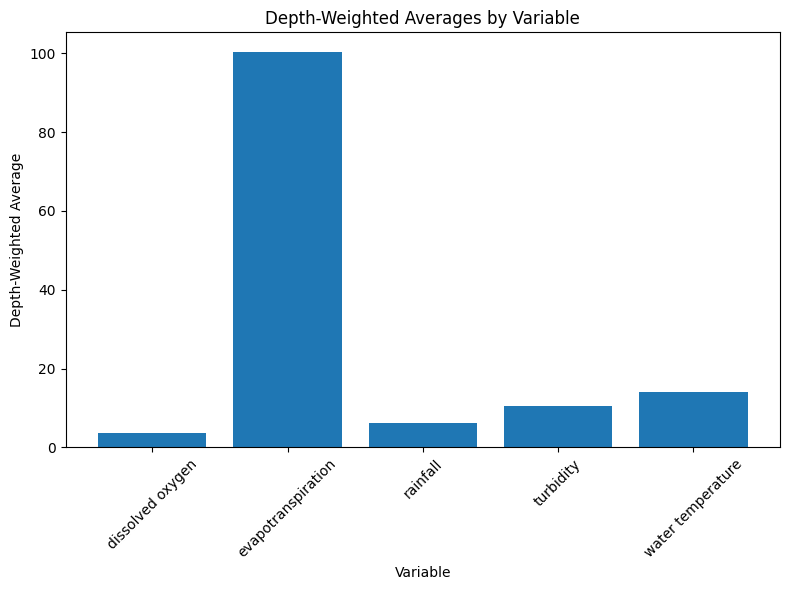

In [ ]:
#1. Depth-Weighted Averages

# Convert depth to numeric, handling missing values
data_cleaned['depth'] = pd.to_numeric(data_cleaned['depth'], errors='coerce')

# Group by variable and calculate depth-weighted average
depth_weighted_avg = (
    data_cleaned.groupby('variable').apply(
        lambda x: (x['depth'] * x['value']).sum() / x['depth'].sum()
    )
).reset_index(name='depth_weighted_avg')

# Plot depth-weighted averages
plt.figure(figsize=(8, 6))
plt.bar(depth_weighted_avg['variable'], depth_weighted_avg['depth_weighted_avg'])
plt.xlabel('Variable')
plt.ylabel('Depth-Weighted Average')
plt.title('Depth-Weighted Averages by Variable')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


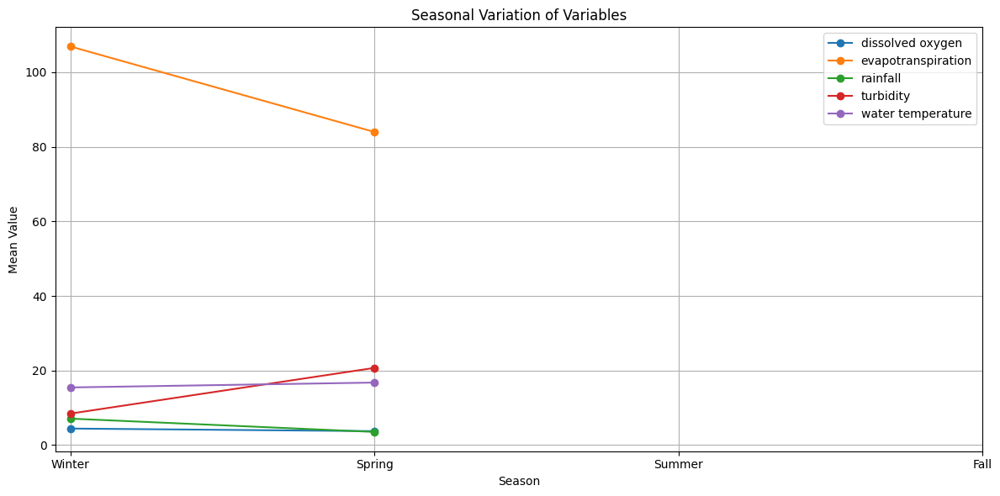

In [ ]:
#2. Seasonal Variation Index

# Convert datetime to pandas datetime object and extract season
data_cleaned['datetime'] = pd.to_datetime(data_cleaned['datetime'])
data_cleaned['season'] = data_cleaned['datetime'].dt.month % 12 // 3 + 1  # 1: Winter, 2: Spring, etc.

# Group by variable and season to calculate mean
seasonal_means = data_cleaned.groupby(['variable', 'season'])['value'].mean().reset_index()

# Plot seasonal variation for each variable
plt.figure(figsize=(12, 6))
for variable in seasonal_means['variable'].unique():
    temp = seasonal_means[seasonal_means['variable'] == variable]
    plt.plot(temp['season'], temp['value'], marker='o', label=variable)

plt.xlabel('Season')
plt.ylabel('Mean Value')
plt.title('Seasonal Variation of Variables')
plt.legend()
plt.xticks([1, 2, 3, 4], ['Winter', 'Spring', 'Summer', 'Fall'])
plt.grid()
plt.tight_layout()
plt.show()


<ipython-input-74-61fc3fc38b25>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  turbidity_spikes['is_spike'] = turbidity_spikes['value'] > turbidity_threshold


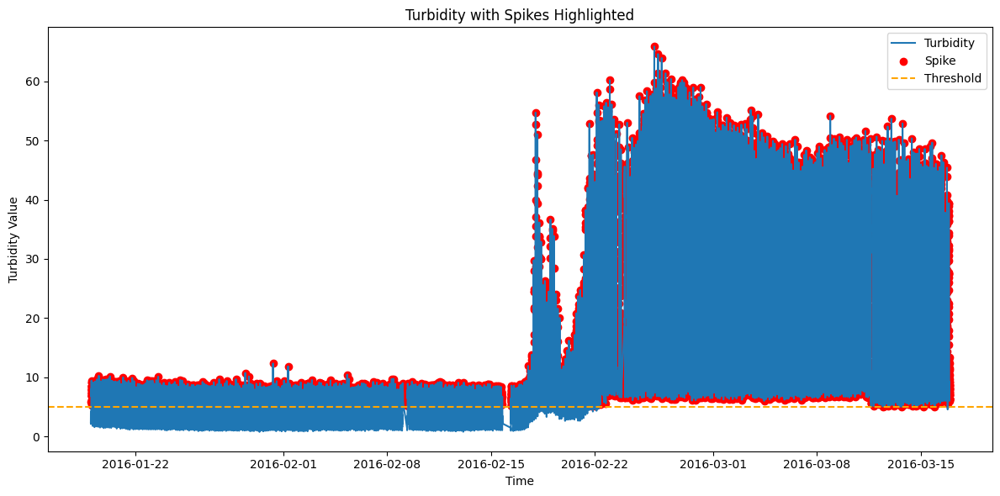

In [ ]:
# 3. Turbidity Spike Rate

# Define turbidity threshold
turbidity_threshold = 5  # Example threshold

# Filter for turbidity variable
turbidity_spikes = data_cleaned[data_cleaned['variable'] == 'turbidity']
turbidity_spikes['is_spike'] = turbidity_spikes['value'] > turbidity_threshold

# Plot turbidity values with spikes highlighted
plt.figure(figsize=(12, 6))
plt.plot(turbidity_spikes['datetime'], turbidity_spikes['value'], label='Turbidity')
plt.scatter(
    turbidity_spikes['datetime'][turbidity_spikes['is_spike']],
    turbidity_spikes['value'][turbidity_spikes['is_spike']],
    color='red',
    label='Spike'
)
plt.axhline(turbidity_threshold, color='orange', linestyle='--', label='Threshold')
plt.xlabel('Time')
plt.ylabel('Turbidity Value')
plt.title('Turbidity with Spikes Highlighted')
plt.legend()
plt.tight_layout()
plt.show()


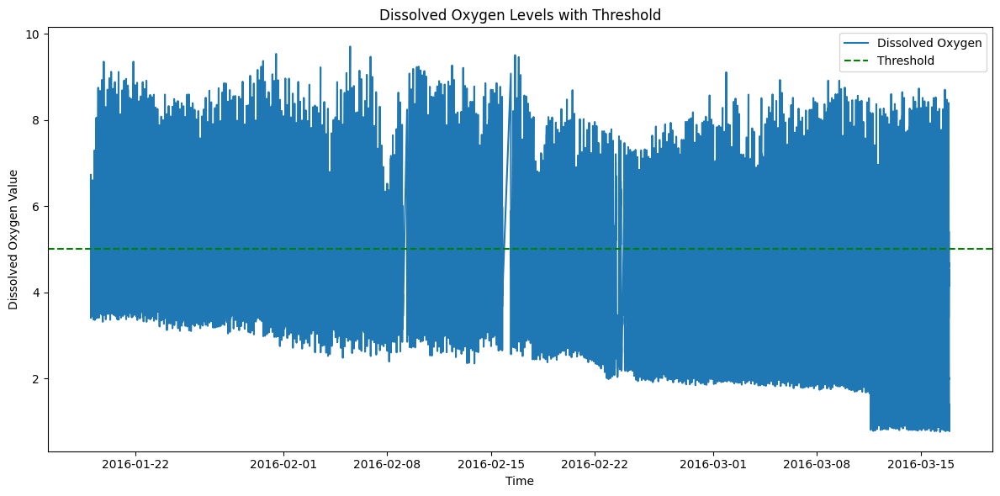

In [ ]:
# 4. Oxygen Saturation Levels

# Define oxygen saturation threshold
oxygen_threshold = 5  # mg/L example threshold

# Filter for dissolved oxygen variable
oxygen_levels = data_cleaned[data_cleaned['variable'] == 'dissolved oxygen']

# Plot dissolved oxygen levels with threshold
plt.figure(figsize=(12, 6))
plt.plot(oxygen_levels['datetime'], oxygen_levels['value'], label='Dissolved Oxygen')
plt.axhline(oxygen_threshold, color='green', linestyle='--', label='Threshold')
plt.xlabel('Time')
plt.ylabel('Dissolved Oxygen Value')
plt.title('Dissolved Oxygen Levels with Threshold')
plt.legend()
plt.tight_layout()
plt.show()


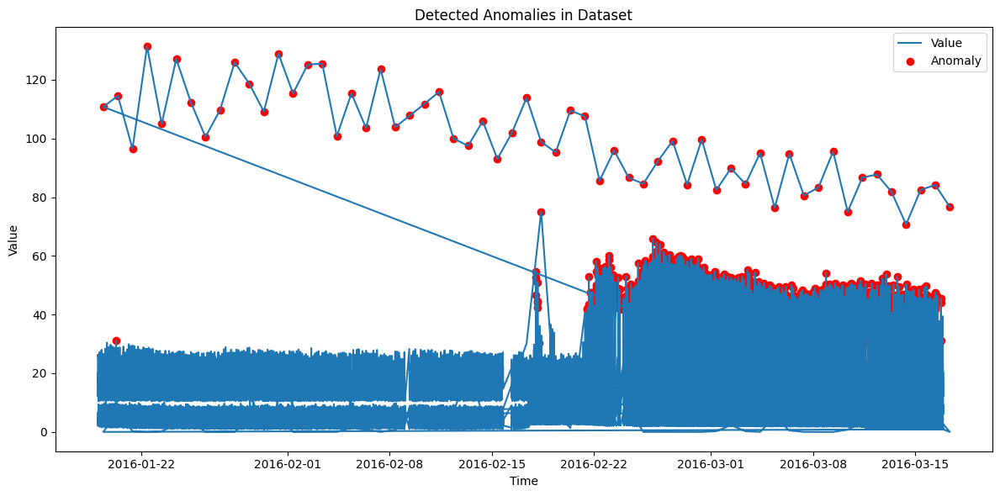

In [ ]:
# 5. Anomaly Rate

from sklearn.ensemble import IsolationForest

# Perform anomaly detection
anomaly_detector = IsolationForest(contamination=0.02, random_state=42)
data_cleaned['anomaly'] = anomaly_detector.fit_predict(data_cleaned[['value']])
data_cleaned['is_anomaly'] = data_cleaned['anomaly'] == -1

# Plot values with anomalies highlighted
plt.figure(figsize=(12, 6))
plt.plot(data_cleaned['datetime'], data_cleaned['value'], label='Value')
plt.scatter(
    data_cleaned['datetime'][data_cleaned['is_anomaly']],
    data_cleaned['value'][data_cleaned['is_anomaly']],
    color='red',
    label='Anomaly'
)
plt.xlabel('Time')
plt.ylabel('Value')
plt.title('Detected Anomalies in Dataset')
plt.legend()
plt.tight_layout()
plt.show()


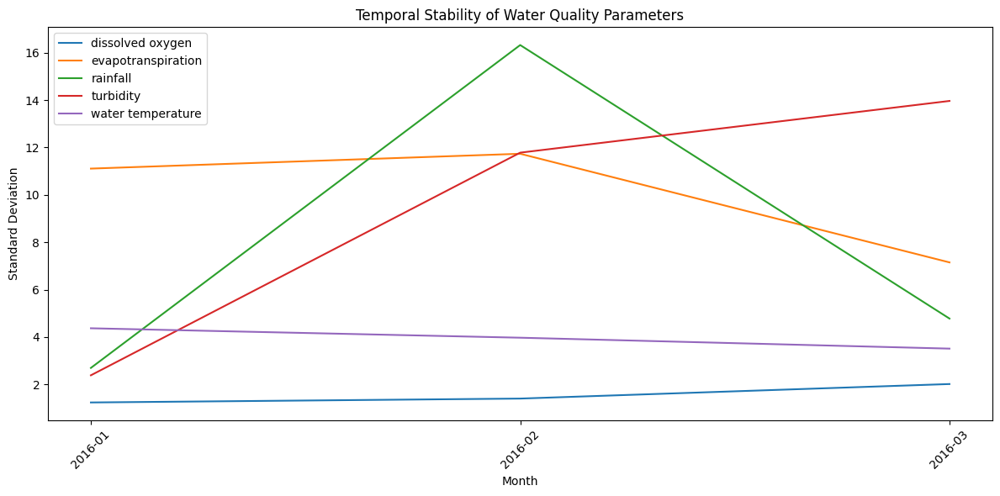

In [ ]:
#6. Temporal Stability of Water Quality




data_cleaned['month'] = data_cleaned['datetime'].dt.to_period('M')  # Monthly aggregation

# Calculate standard deviation for each variable over months
stability = data_cleaned.groupby(['variable', 'month'])['value'].std().reset_index()

# Plot temporal stability
plt.figure(figsize=(12, 6))
for variable in stability['variable'].unique():
    temp = stability[stability['variable'] == variable]
    plt.plot(temp['month'].astype(str), temp['value'], label=variable)

plt.xlabel('Month')
plt.ylabel('Standard Deviation')
plt.title('Temporal Stability of Water Quality Parameters')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()


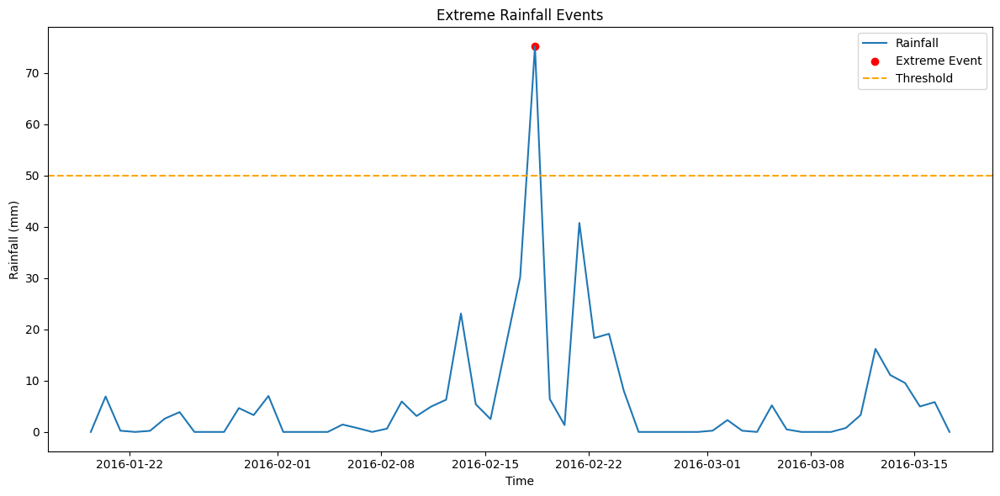

In [ ]:
#7. Depth Coverage Ratio

# Assume rainfall is a variable in the dataset; set a threshold for extreme rainfall
extreme_rainfall_threshold = 50  # Example threshold in mm/day

# Filter for extreme rainfall events and count their occurrences
data_cleaned['extreme_event'] = data_cleaned['value'] > extreme_rainfall_threshold
extreme_events = data_cleaned[data_cleaned['variable'] == 'rainfall']['extreme_event'].sum()

# Plot rainfall with extreme events highlighted
rainfall_data = data_cleaned[data_cleaned['variable'] == 'rainfall']
plt.figure(figsize=(12, 6))
plt.plot(rainfall_data['datetime'], rainfall_data['value'], label='Rainfall')
plt.scatter(
    rainfall_data['datetime'][rainfall_data['extreme_event']],
    rainfall_data['value'][rainfall_data['extreme_event']],
    color='red',
    label='Extreme Event'
)
plt.axhline(extreme_rainfall_threshold, color='orange', linestyle='--', label='Threshold')
plt.xlabel('Time')
plt.ylabel('Rainfall (mm)')
plt.title('Extreme Rainfall Events')
plt.legend()
plt.tight_layout()
plt.show()


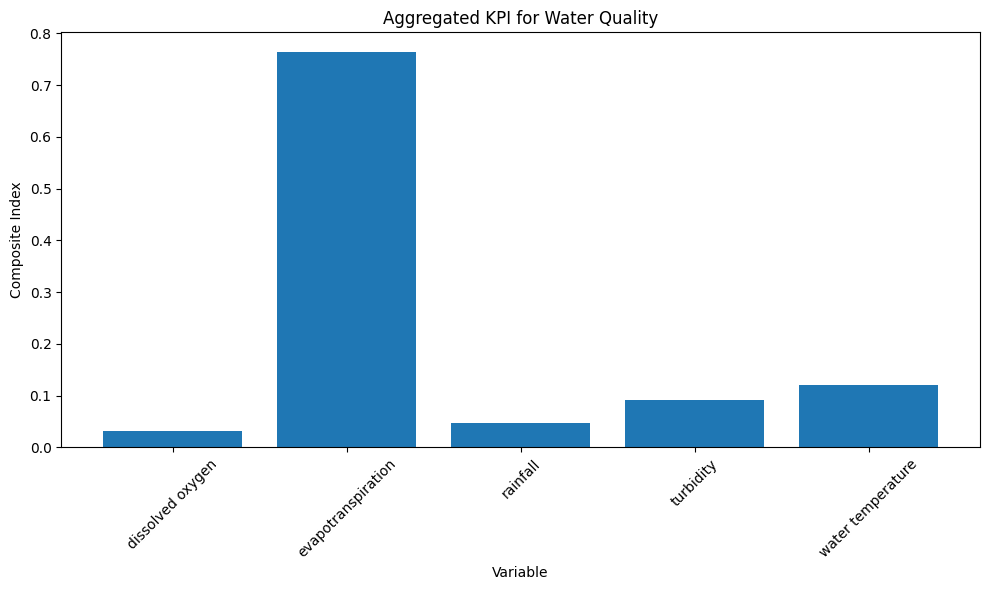

In [ ]:
#9. Aggregated KPI for Water Quality

# Normalize key parameters and calculate a composite index
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
data_cleaned['normalized_value'] = scaler.fit_transform(data_cleaned[['value']])

# Aggregate normalized values by variable to create a composite index
composite_index = data_cleaned.groupby('variable')['normalized_value'].mean().reset_index()
composite_index.columns = ['Variable', 'Composite Index']

# Plot composite index
plt.figure(figsize=(10, 6))
plt.bar(composite_index['Variable'], composite_index['Composite Index'])
plt.xlabel('Variable')
plt.ylabel('Composite Index')
plt.title('Aggregated KPI for Water Quality')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


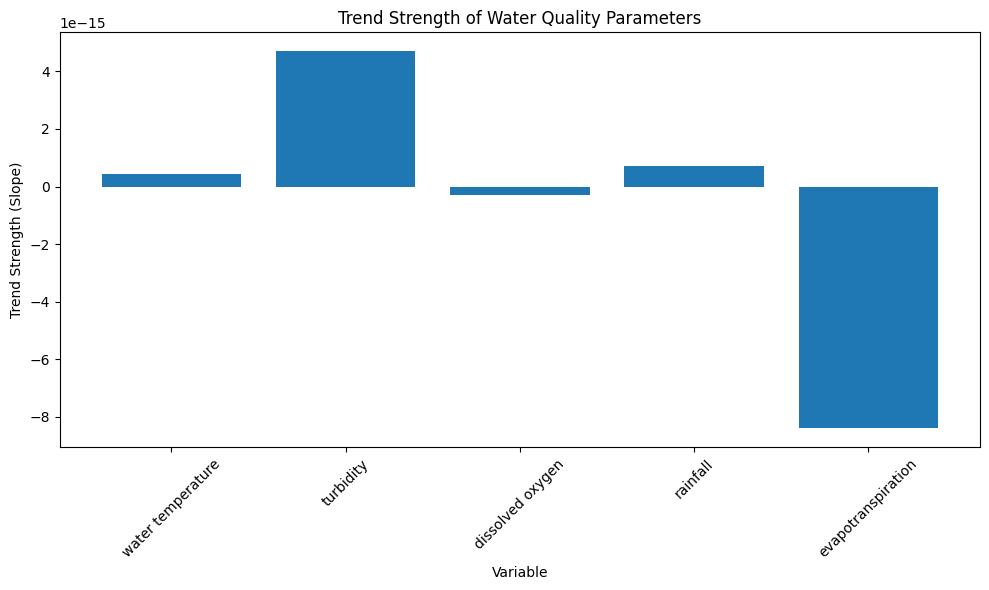

In [ ]:
# 12. Trend Strength Indicator

from scipy.stats import linregress

# Function to calculate trend slope for each variable
def calculate_trend(data, variable):
    subset = data[data['variable'] == variable]
    x = pd.to_numeric(subset['datetime']).values
    y = subset['value'].values
    slope, _, _, _, _ = linregress(x, y)
    return slope

# Calculate trends for all variables
trends = {var: calculate_trend(data_cleaned, var) for var in data_cleaned['variable'].unique()}

# Convert to DataFrame for plotting
trend_data_cleaned = pd.DataFrame(list(trends.items()), columns=['Variable', 'Trend Strength'])

# Plot trend strengths
plt.figure(figsize=(10, 6))
plt.bar(trend_data_cleaned['Variable'], trend_data_cleaned['Trend Strength'])
plt.xlabel('Variable')
plt.ylabel('Trend Strength (Slope)')
plt.title('Trend Strength of Water Quality Parameters')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


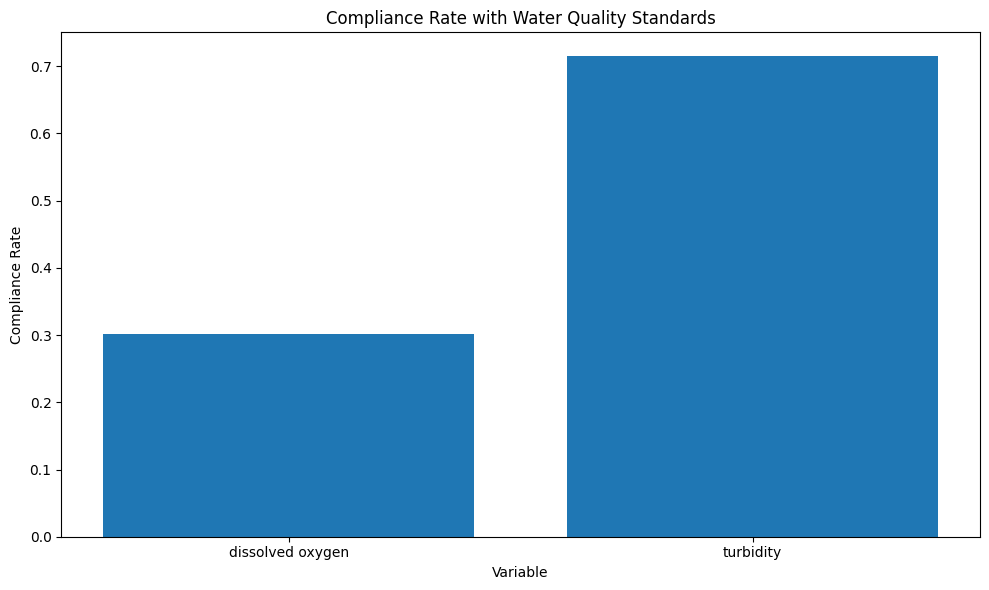

In [ ]:
#13. Compliance Rate with Water Quality Standards

# Define compliance thresholds for variables
thresholds = {'dissolved oxygen': 5, 'turbidity': 5}  # Example thresholds
compliance = {}

for var, threshold in thresholds.items():
    subset = data_cleaned[data_cleaned['variable'] == var]
    compliance[var] = (subset['value'] >= threshold).mean()

# Convert to DataFrame for plotting
compliance_data_cleaned = pd.DataFrame(list(compliance.items()), columns=['Variable', 'Compliance Rate'])

# Plot compliance rates
plt.figure(figsize=(10, 6))
plt.bar(compliance_data_cleaned['Variable'], compliance_data_cleaned['Compliance Rate'])
plt.xlabel('Variable')
plt.ylabel('Compliance Rate')
plt.title('Compliance Rate with Water Quality Standards')
plt.tight_layout()
plt.show()


In [ ]:

import pandas as pd
import plotly.express as px

# Load the dataset
file_path = 'Scenario_Data_Set.csv'
dataset = pd.read_csv(file_path)

# Calculate missing values
missing_values = dataset.isnull().sum().reset_index()
missing_values.columns = ["Column", "Missing Values"]

# Create a bar chart
fig_missing_values = px.bar(
    missing_values,
    x="Column",
    y="Missing Values",
    title="Missing Values Distribution",
    labels={"Missing Values": "Count of Missing Values"}
)
fig_missing_values.show()



In [ ]:
# Create a histogram for the depth column
fig_depth = px.histogram(
    dataset,
    x="depth",
    nbins=30,
    title="Depth Distribution",
    labels={"depth": "Depth (meters)"},
)
fig_depth.show()


In [ ]:
# Create a histogram for the value column
fig_value = px.histogram(
    dataset,
    x="value",
    nbins=30,
    title="Value Distribution",
    labels={"value": "Recorded Values"},
)
fig_value.show()


In [ ]:
# Calculate counts for each variable category
variable_counts = dataset["variable"].value_counts().reset_index()
variable_counts.columns = ["Variable", "Count"]

# Create a bar chart for variable categories
fig_variable = px.bar(
    variable_counts,
    x="Variable",
    y="Count",
    title="Distribution of Variable Categories",
    labels={"Count": "Count of Categories"},
)
fig_variable.show()




1. Temporal Trends
Seasonal Patterns in Water Temperature and Dissolved Oxygen Levels **bold text**

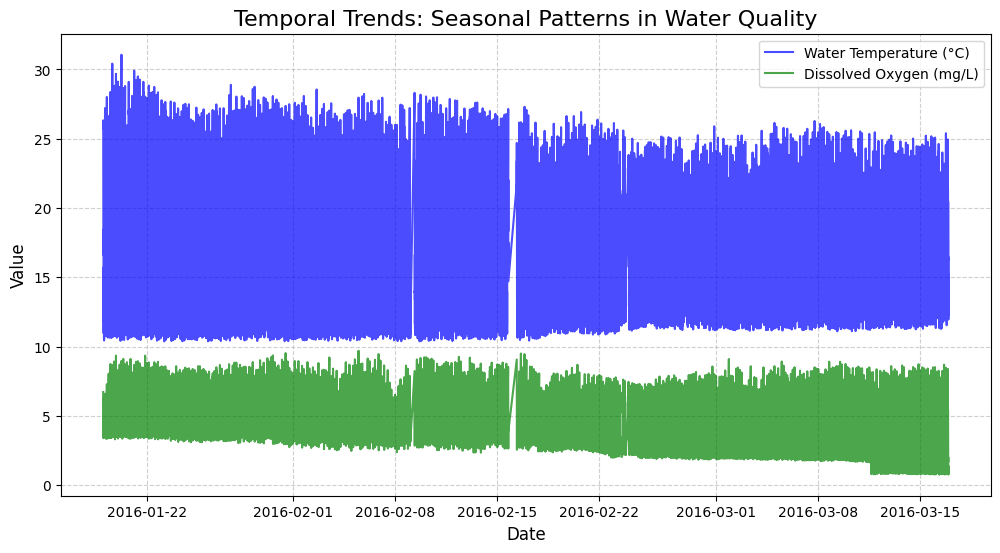

In [ ]:
import matplotlib.pyplot as plt

# Step 1: Filter data for specific variables
water_temp = data_cleaned[data_cleaned['variable'] == 'water temperature']
oxygen_levels = data_cleaned[data_cleaned['variable'] == 'dissolved oxygen']

# Step 2: Plot seasonal trends (assuming datetime is the index)
plt.figure(figsize=(12, 6))
plt.plot(water_temp['datetime'], water_temp['value'], label='Water Temperature (°C)', color='blue', alpha=0.7)
plt.plot(oxygen_levels['datetime'], oxygen_levels['value'], label='Dissolved Oxygen (mg/L)', color='green', alpha=0.7)
plt.title("Temporal Trends: Seasonal Patterns in Water Quality", fontsize=16)
plt.xlabel("Date", fontsize=12)
plt.ylabel("Value", fontsize=12)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.6)
plt.show()


2. Correlation Analysis
Strong Linkage Between Weather Variables and Water Quality

Available Variables: ['water temperature' 'turbidity' 'dissolved oxygen' 'rainfall'
 'evapotranspiration']


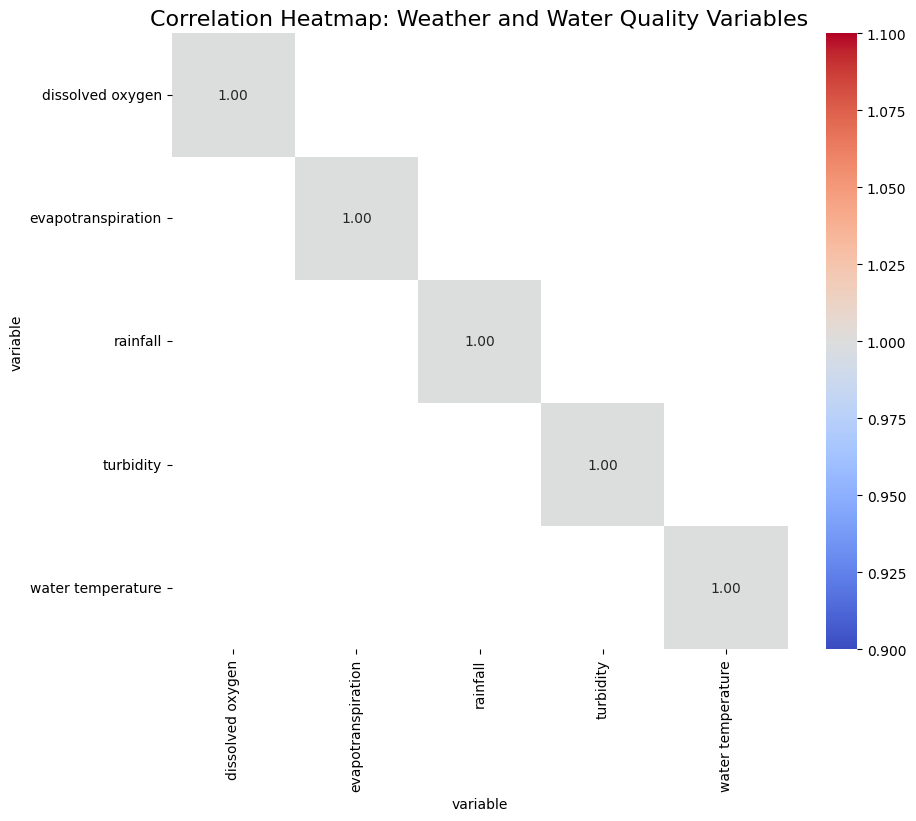

In [ ]:
# Step 1: Check for available variables in the dataset
available_columns = data_cleaned['variable'].unique()
print("Available Variables:", available_columns)

# Step 2: Filter selected_columns to include only available variables
selected_columns = [col for col in ['rainfall', 'evaporation', 'dissolved oxygen', 'turbidity', 'water temperature'] if col in available_columns]

# Step 3: Pivot the data and compute correlations
corr_data = data_cleaned.pivot_table(index='datetime', columns='variable', values='value')
#corr_data = corr_data[selected_columns].dropna()

# Step 4: Compute the correlation matrix
corr_matrix = corr_data.corr()

# Step 5: Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f", cbar=True, square=True)
plt.title("Correlation Heatmap: Weather and Water Quality Variables", fontsize=16)
plt.show()


3. Depth Impact
Stratification Effects in Turbidity and Oxygen Levels

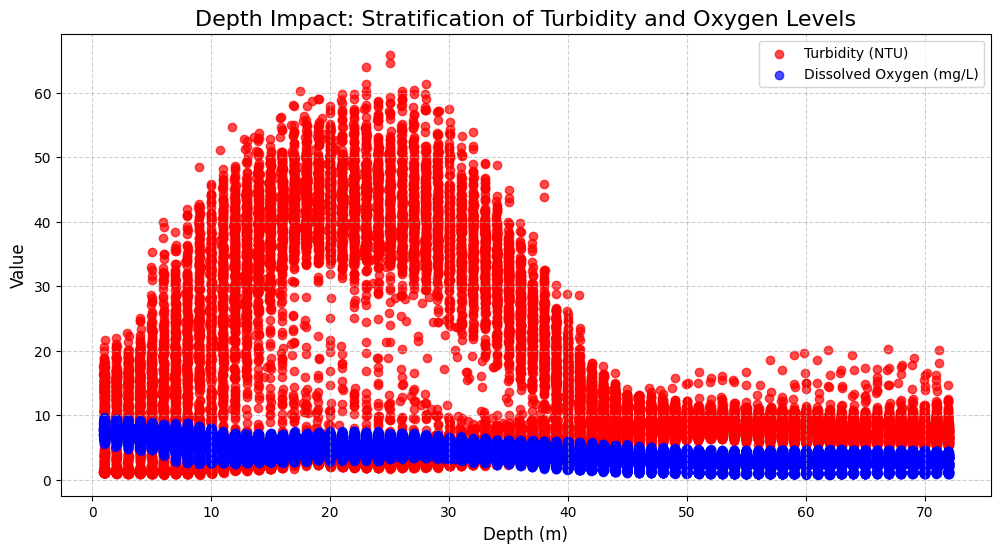

In [ ]:
# Step 1: Filter data for turbidity and oxygen levels
turbidity = data_cleaned[data_cleaned['variable'] == 'turbidity']
oxygen_depth = data_cleaned[data_cleaned['variable'] == 'dissolved oxygen']

# Step 2: Plot turbidity and oxygen levels by depth
plt.figure(figsize=(12, 6))
plt.scatter(turbidity['depth'], turbidity['value'], label='Turbidity (NTU)', alpha=0.7, color='red')
plt.scatter(oxygen_depth['depth'], oxygen_depth['value'], label='Dissolved Oxygen (mg/L)', alpha=0.7, color='blue')
plt.title("Depth Impact: Stratification of Turbidity and Oxygen Levels", fontsize=16)
plt.xlabel("Depth (m)", fontsize=12)
plt.ylabel("Value", fontsize=12)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.6)
plt.show()


In [ ]:
# Filter data for turbidity
turbidity_data = data_cleaned[data_cleaned['variable'] == 'turbidity']

# Ensure data is sorted by datetime
turbidity_data = turbidity_data.sort_values(by='datetime')


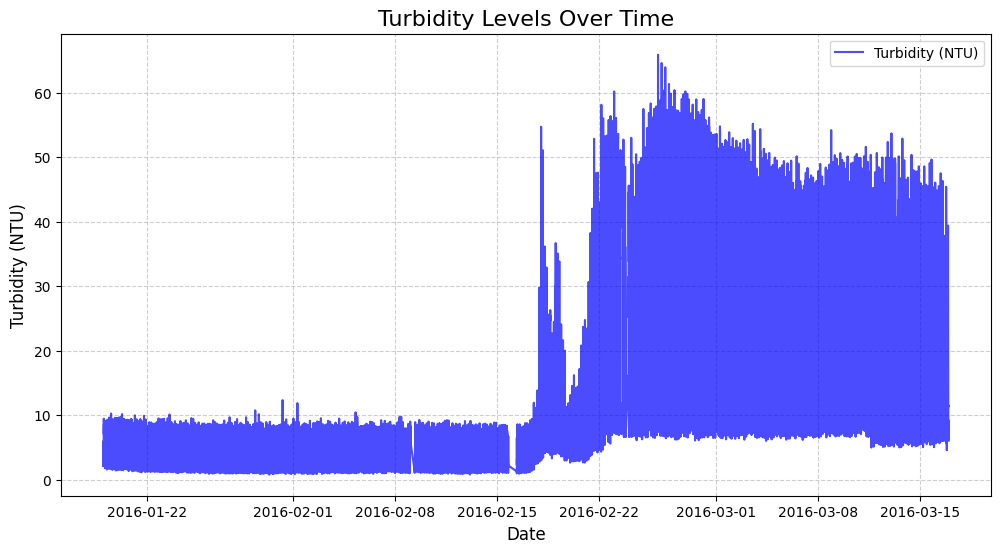

In [ ]:
import matplotlib.pyplot as plt

# Plot turbidity levels over time
plt.figure(figsize=(12, 6))
plt.plot(turbidity_data['datetime'], turbidity_data['value'], label='Turbidity (NTU)', color='blue', alpha=0.7)
plt.title("Turbidity Levels Over Time", fontsize=16)
plt.xlabel("Date", fontsize=12)
plt.ylabel("Turbidity (NTU)", fontsize=12)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.6)
plt.show()


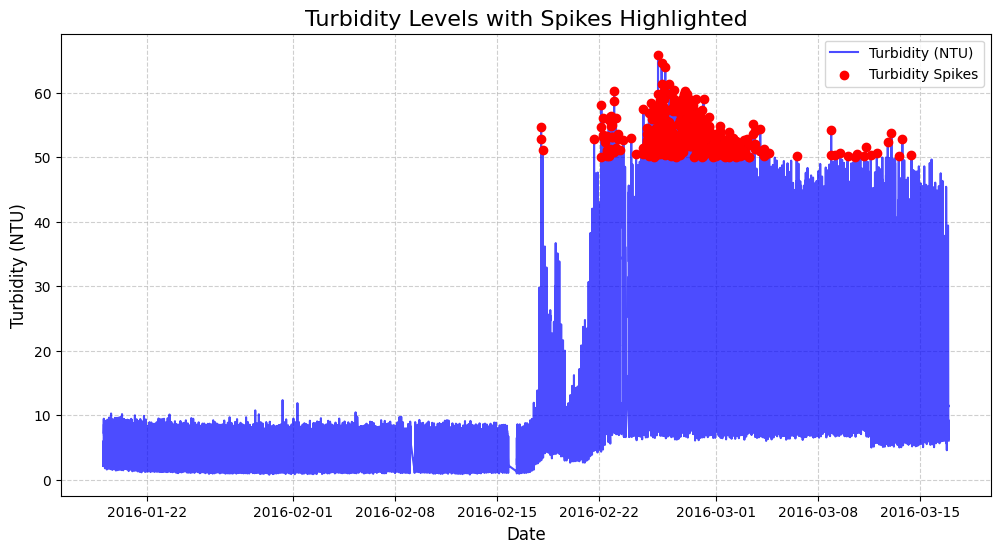

In [ ]:
# Define a threshold for turbidity spikes
spike_threshold = 50  # Adjust based on domain knowledge

# Identify spikes
turbidity_data['is_spike'] = turbidity_data['value'] > spike_threshold

# Plot turbidity levels with spikes highlighted
plt.figure(figsize=(12, 6))
plt.plot(turbidity_data['datetime'], turbidity_data['value'], label='Turbidity (NTU)', color='blue', alpha=0.7)
plt.scatter(
    turbidity_data['datetime'][turbidity_data['is_spike']],
    turbidity_data['value'][turbidity_data['is_spike']],
    color='red',
    label='Turbidity Spikes',
    zorder=5
)
plt.title("Turbidity Levels with Spikes Highlighted", fontsize=16)
plt.xlabel("Date", fontsize=12)
plt.ylabel("Turbidity (NTU)", fontsize=12)
plt.legend()
plt.grid(True, linestyle="--", alpha=0.6)
plt.show()


In [ ]:
import plotly.graph_objects as go
import pandas as pd
import numpy as np
from scipy.stats import linregress

# Ensure the datetime column is in the correct format
data_cleaned['datetime'] = pd.to_datetime(data_cleaned['datetime'])

# Check if 'is_anomaly' column exists, if not create it (example: anomalies are values > mean + 3*std)
if 'is_anomaly' not in data_cleaned.columns:
    data_cleaned['is_anomaly'] = data_cleaned['value'] > data_cleaned['value'].mean() + 3 * data_cleaned['value'].std()

# Calculate trend line
data_cleaned['ordinal_date'] = data_cleaned['datetime'].map(pd.Timestamp.toordinal)  # Convert datetime to ordinal
x = data_cleaned['ordinal_date']
y = data_cleaned['value']
slope, intercept, _, _, _ = linregress(x, y)
data_cleaned['trend'] = slope * x + intercept

# Create scatter plot with trend line
fig_anomalies = go.Figure()

# Add scatter points
fig_anomalies.add_trace(go.Scatter(
    x=data_cleaned['datetime'],
    y=data_cleaned['value'],
    mode='markers',
    name='Water Quality Parameter',
    marker=dict(color=['orange' if is_anom else 'blue' for is_anom in data_cleaned['is_anomaly']]),
    text=data_cleaned['is_anomaly']
))

# Add trend line
fig_anomalies.add_trace(go.Scatter(
    x=data_cleaned['datetime'],
    y=data_cleaned['trend'],
    mode='lines',
    name='Trend Line',
    line=dict(color='green', dash='dash')
))

# Update layout
fig_anomalies.update_layout(
    title="Anomalies in Water Quality Parameters with Trend Line",
    xaxis_title="Timestamp",
    yaxis_title="Water Quality Parameter",
    legend_title="Legend"
)

fig_anomalies.show()
